# Homework

Group 9
* Yufei Chu 
* Kavish Vijay Daftari


Task

- On np-based implementation: Code a cross-entropy cost function. Does cross-entropy train faster than MSE? Is accuracy improved? 

- On tensorflow implementation: Code a minibatch. What's the best batch size for an MSE loss?





imoprt the libraries

In [1]:
import numpy as np
print("Numpy version: "+np.__version__)
from sklearn import __version__ as skver
print("Scikit-learn version: "+skver)
from sklearn.datasets import make_blobs
from sklearn.model_selection import train_test_split
%matplotlib inline
import matplotlib.pylab as plt
print("Matplotlib version: "+plt.__version__)

Numpy version: 1.23.2
Scikit-learn version: 1.2.1
Matplotlib version: 1.23.2


In [50]:
N = 2000  # number of samples
X, Y = make_blobs(n_samples=N, centers=[[1, 1], [-1, 1], [1, -1], [-1, -1]], cluster_std=0.5)

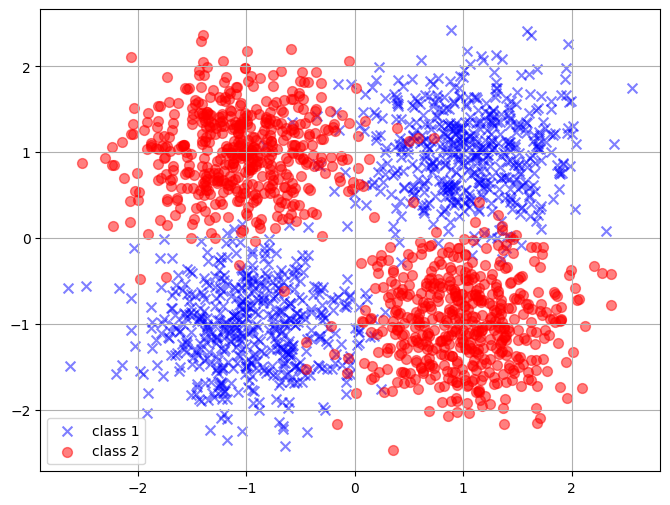

In [51]:
# Make it a two-class problem:
Y[Y==2] = 1.0
Y[Y==3] = 0.0 

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(1, 1, 1)
ax.scatter(X[Y==0, 0], X[Y==0, 1], c='b', marker='x', 
           s=50, alpha=0.5, label='class 1')
ax.scatter(X[Y==1, 0], X[Y==1, 1], c='r', marker='o', 
           s=50, alpha=0.5, label='class 2')
plt.legend()
plt.grid()

Let's create a meshgrid for the probability plots:

In [52]:
# Simple train, test split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, train_size=0.25, test_size=0.75)

x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.05), np.arange(y_min, y_max, 0.05))

Let's save the datasets:

In [53]:
import pickle
data1 = (X, Y)
data2 = (X_train, X_test, Y_train, Y_test)

# open a file, where you ant to store the data
file1 = open(r'make_blobs1.pck', 'wb')
file2 = open(r'make_blobs2.pck', 'wb')

# dump information to that file
pickle.dump(data1, file1)
pickle.dump(data2, file2)
file1.close()
file2.close()

We use our previous pure-numpy ANN implementation, with a

- Mean-square error (mse) cost function
- An output layer with one neuron (two classes) and a sigmoid activation function
- A single hidden layer with tanh activation function

In [6]:
def sigmoid(x):
    return 1.0/(1.0 + np.exp(-x))

class Layer:
    def __init__(self, x, n, activation="tanh"):        
        self.n_input = x
        self.n_neurons = n
        self.activation = activation
        self.W = np.zeros(shape=(x, n)) # weights
        self.b = np.zeros(shape=(n, )) # bias
        self.initialize_parameters()  
        self.z = np.zeros(shape=(n)) # z = Wx + b
        self.y = np.zeros(shape=(n)) # y = sgm(z)
        
    def initialize_parameters(self):
        if self.activation == "tanh":
            self.W = np.array(np.random.uniform(low=-np.sqrt(6.0/(self.n_input + self.n_neurons)),
                                                high=np.sqrt(6.0/(self.n_input + self.n_neurons)),
                                                size=(self.n_input, self.n_neurons)))
        else: 
            self.W = np.array(np.zeros(shape=(self.n_input, self.n_neurons)))
            
        # zero bias
        self.b = np.zeros(shape=(self.n_neurons, ))
        
    def output(self, x):  #  x is an array N_input x 1
        self.z = np.dot(x, self.W) + self.b
        if self.activation == "tanh":
            self.y = np.tanh(self.z)
        elif self.activation == "sigmoid":
            self.y = sigmoid(self.z)
        return self.y
    
class nn:
    def __init__(self, x, n_hidden):
        self.layers = []
        self.n_output = 1
        self.n_hidden = n_hidden
        self.output_activation = "sigmoid"
        if n_hidden > 0:
            self.layers.append(Layer(x, n_hidden)) #  hidden layers use tanh activation
            self.layers.append(Layer(n_hidden, self.n_output, activation="sigmoid"))
        else:
            self.layers.append(Layer(x, self.n_output, activation="sigmoid"))
            
    def predict_proba(self, x):
        for layer in self.layers:
            x = layer.output(x)
        return x
        
    def predict(self, x):
        x = self.predict_proba(x)
        if self.output_activation is "sigmoid":
            return x > 0.5
        elif self.output_activation is "tanh":
            return x > 0.0
        
    def reset(self):
        for layer in self.layers:
            layer.initialize_parameters()
    
    def mse(self, x, y):
        e = self.predict_proba(x)[:,0] - y
        return np.mean(np.power(e, 2.0))

<>:53: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:55: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:53: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:55: SyntaxWarning: "is" with a literal. Did you mean "=="?
/var/folders/1r/4wsb9xsn57qg4s1b2wwvhblm0000gn/T/ipykernel_91799/3902990919.py:53: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if self.output_activation is "sigmoid":
/var/folders/1r/4wsb9xsn57qg4s1b2wwvhblm0000gn/T/ipykernel_91799/3902990919.py:55: SyntaxWarning: "is" with a literal. Did you mean "=="?
  elif self.output_activation is "tanh":


In [7]:
class Trainer:
    def __init__(self, classifier, learning_rate=1.0, max_epoch=1000):
        self.classifier = classifier
        self.lr = learning_rate
        self.train_cost = np.zeros(shape=(max_epoch,))
        self.test_cost = np.zeros(shape=(max_epoch, ))   
        self.max_epoch = max_epoch
        self.current_epoch = 0

    def update(self, data_train, label_train, data_test, label_test, batch_size=32):
        if self.current_epoch == 0:  
            self.train_cost[0] =  self.classifier.mse(data_train, label_train) 
            self.test_cost[0] =  self.classifier.mse(data_test, label_test) 
        # Present mini-batches in different order each epoch
        else:        
            rand_perm = np.random.permutation(len(label_train))
            data_train = data_train[rand_perm, :].copy()
            label_train = label_train[rand_perm].copy()
            self.minibach_eval(data_train, label_train, batch_size)
            self.train_cost[self.current_epoch] = self.classifier.mse(data_train, label_train) # Lose function
            self.test_cost[self.current_epoch] =  self.classifier.mse(data_test, label_test)               
        self.current_epoch += 1
    
    def reset(self):
        self.classifier.reset()        

    def minibach_eval(self, data, labels, batch_size=32):
        averaged_cost = 0.0
        n = len(labels)
        for nbatches, (start, end) in enumerate(zip(range(0, n, batch_size), range(batch_size, n + 1, batch_size))):
            self.train(data[start:end], labels[start:end])
        #return averaged_cost/nbatches
    
    def train(self, data, labels):
        n = len(labels)
        error = (self.classifier.predict_proba(data)[:, 0] - labels)[:, np.newaxis]
        nlayer = len(self.classifier.layers)
        
        # This considers an outer layer with one neuron
        layer_idx = nlayer - 1 
        out_layer = self.classifier.layers[layer_idx]
        tmp = np.multiply(error, sigmoid(out_layer.z) * (1.0 - sigmoid(out_layer.z)))
        grad_b = np.mean(tmp, axis=0)
        if nlayer == 1:
            grad_w = np.mean(np.multiply(np.tile(tmp, (1, out_layer.n_input)), data), axis=0)
        else:
            hidden_layer = self.classifier.layers[layer_idx - 1]
            grad_w = np.mean(np.multiply(np.tile(tmp, (1, out_layer.n_input)), hidden_layer.y), axis=0) 
            
        # gradient descent
        self.classifier.layers[layer_idx].W -= self.lr * grad_w[:, np.newaxis]
        self.classifier.layers[layer_idx].b -= self.lr * grad_b
        
        # Train the hidden layer
        if nlayer > 1:
            nh = out_layer.n_input
            e = np.tile(error * sigmoid(out_layer.z) * (1.0 - sigmoid(out_layer.z)), (1, nh))
            tmp = np.multiply(np.multiply(e, 1.0 - np.tanh(hidden_layer.z)**2), np.tile(out_layer.W.T, (n, 1)))
            grad_b = np.mean(tmp, axis=0)
            grad_w = np.dot(tmp.T, data).T
            
            # gradient descent
            self.classifier.layers[layer_idx-1].W -= self.lr * grad_w
            self.classifier.layers[layer_idx-1].b -= self.lr * grad_b

## Training epoch by epoch

- Try changing the number of neurons in the hidden layer
- Try changing the learning rate
- Try changing mini-batch size

In [8]:
classifier = nn(X.shape[1], n_hidden = 5)
trainer = Trainer(classifier, learning_rate=0.5, max_epoch=1000)

In [9]:
X.shape[1]

2

Run the next block < 100 times

If the mean of loss < 0.058(this value mean the loss will decrease so slowly for next epoch), we would stop to train it.

/var/folders/1r/4wsb9xsn57qg4s1b2wwvhblm0000gn/T/ipykernel_91470/3537513395.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12, 5))


i: 78


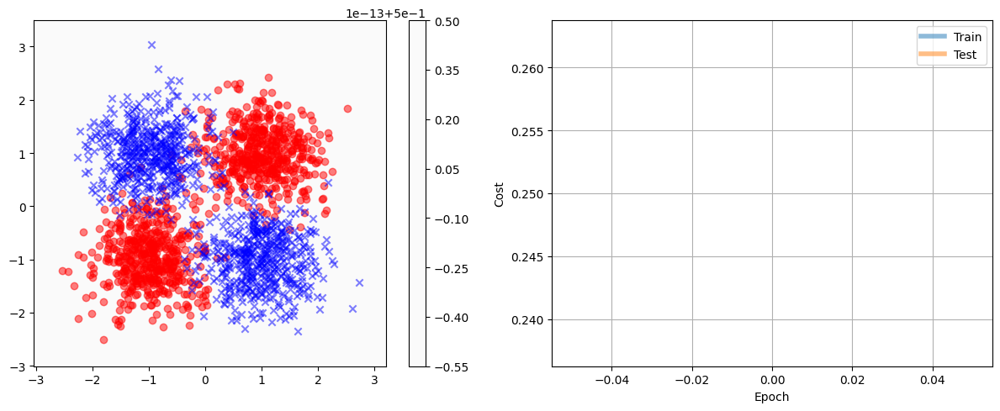

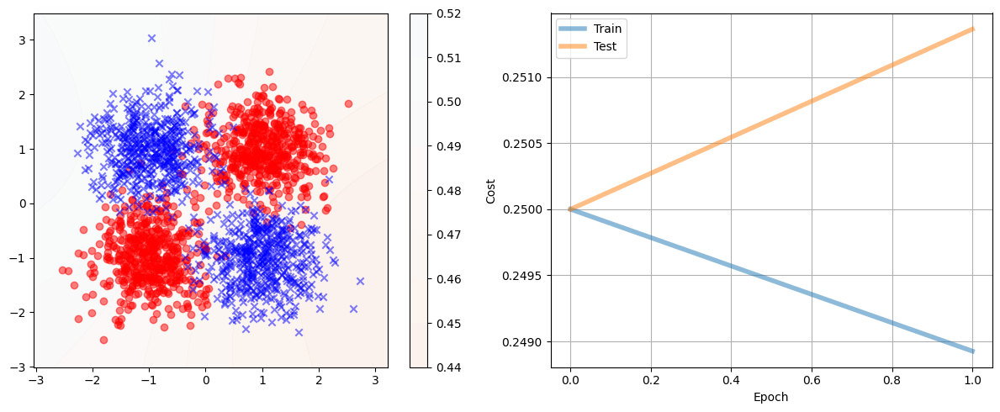

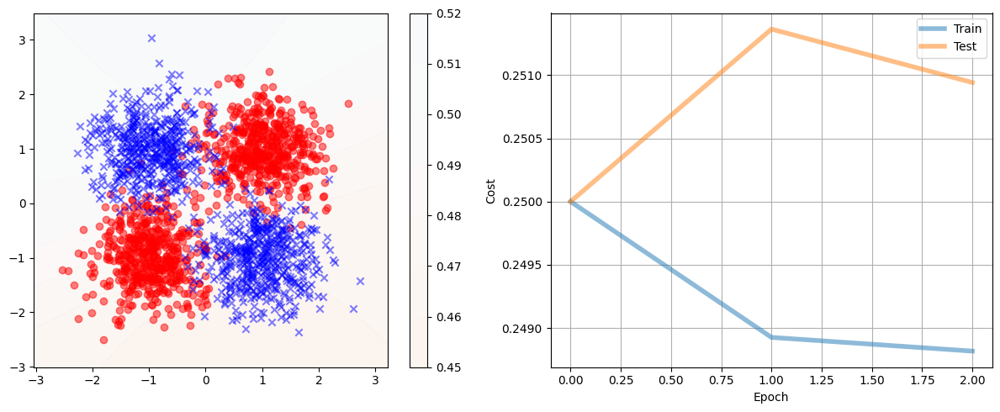

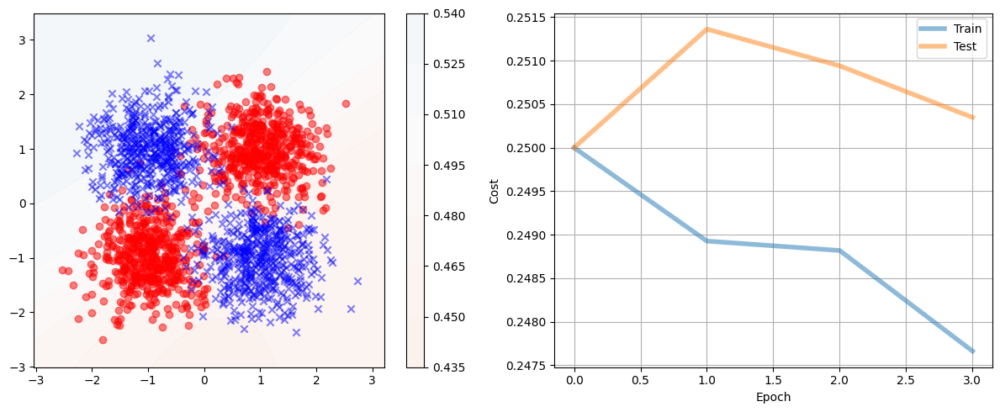

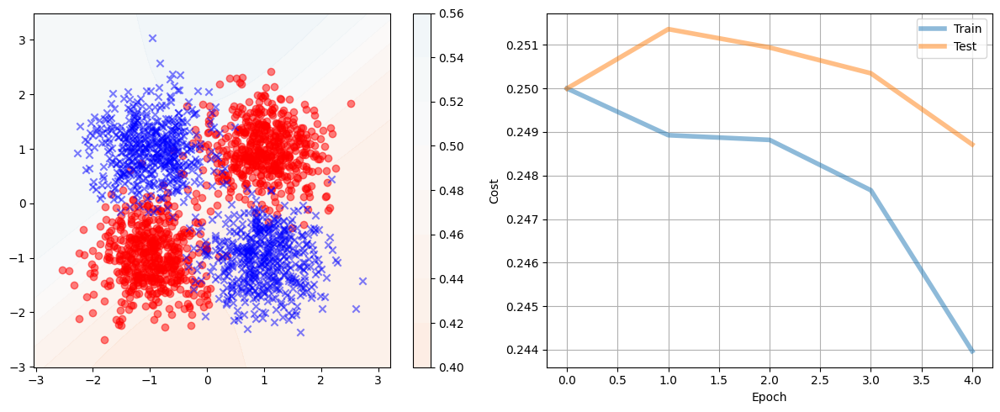

...

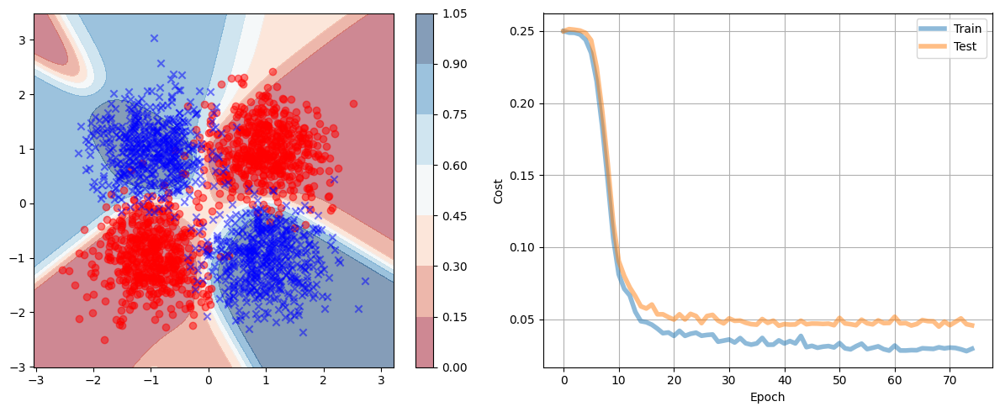

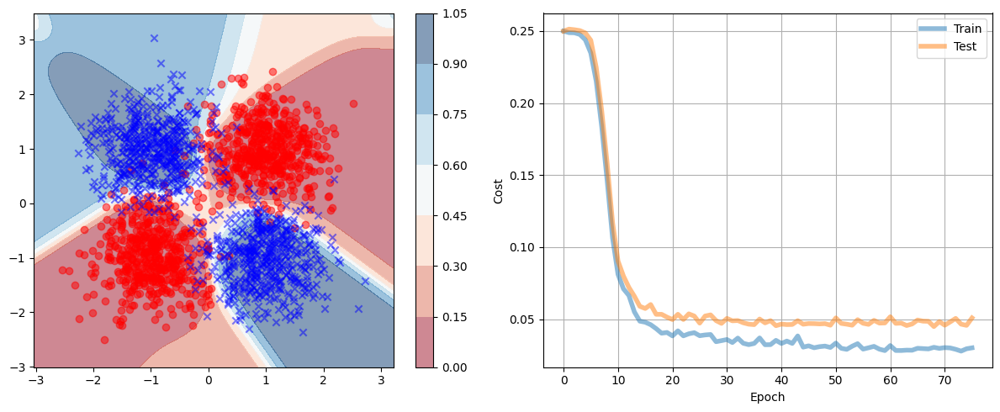

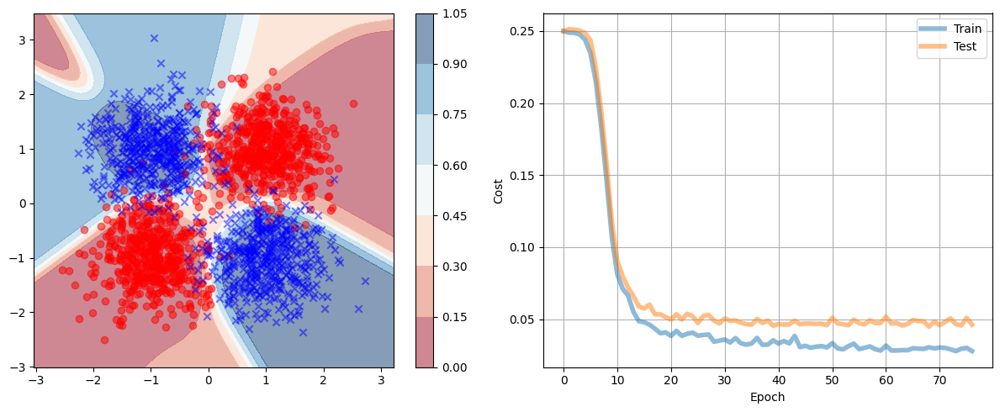

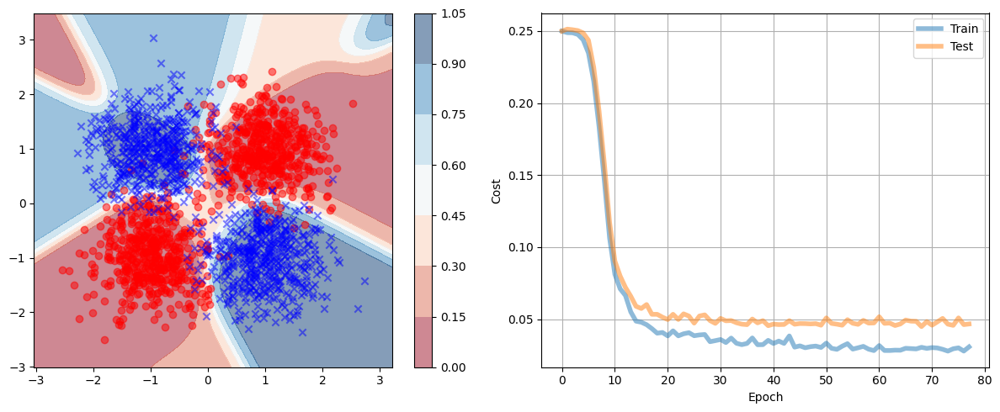

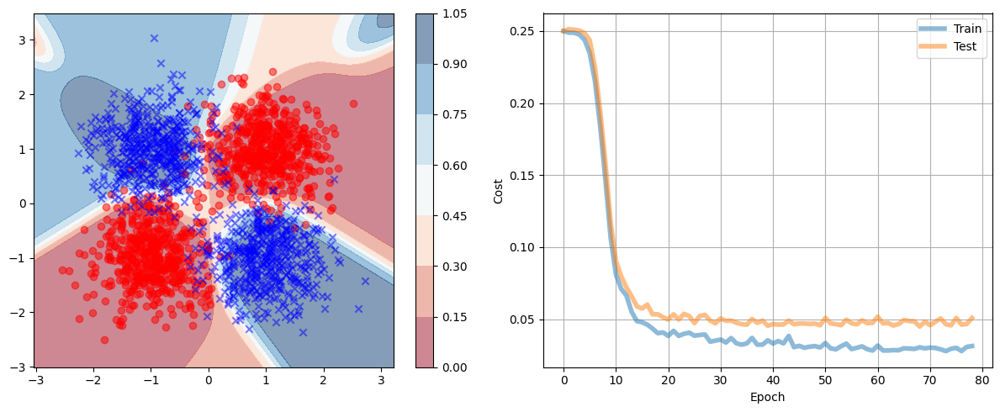

In [10]:
import time
start = time.time()

for i in range(100):
    trainer.update(X_train, Y_train, X_test, Y_test, batch_size=10)
    pred_labels = classifier.predict(X_test)
    
    fig = plt.figure(figsize=(12, 5))
    ax = fig.add_subplot(1, 2, 1)
    Z = classifier.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:,0]
    cf = ax.contourf(xx, yy, Z.reshape(xx.shape), cmap=plt.cm.RdBu, alpha=0.5, vmin=0.0, vmax=1.0)
    plt.colorbar(cf)
    ax.scatter(X[Y==0, 0], X[Y==0, 1], color='r', marker='o', alpha=0.5)
    ax.scatter(X[Y==1, 0], X[Y==1, 1], color='b', marker='x', alpha=0.5)

    ax = fig.add_subplot(1, 2, 2)
    ax.plot(np.arange(0, trainer.current_epoch, step=1), 
            trainer.train_cost[:trainer.current_epoch], linewidth=4, alpha=0.5, label="Train")

    ax.plot(np.arange(0, trainer.current_epoch, step=1), 
            trainer.test_cost[:trainer.current_epoch], linewidth=4, alpha=0.5, label="Test")
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Cost')
    plt.legend()
    plt.grid()
    plt.tight_layout()
    
    if(trainer.train_cost[:trainer.current_epoch].mean()<0.058):
        end = time.time()
        break
        
print("i:", i)

Calculate the running time

In [11]:
print("time :", end-start)

time : 4.957276821136475


In [13]:
mse_true = 0
for i in pred_labels:
    if(i[0] == True):
        mse_true+=1
        
print("The MSE accuracy is ", mse_true/1500.0)

The MSE accuracy is  0.48


### Conclusion

When we use MSE, we have to train 78 times and use 4.9573 seconds

## Cross entropy

Building cross-entropy function 
* Cross-entropy loss or log loss function is used as a cost function for logistic regression models or models with softmax output (multinomial logistic regression or neural network) in order to estimate the parameters
* Redefine the class nn, changing the mse to cross-entropy

In [8]:
class nn_cross:
    def __init__(self, x, n_hidden):
        self.layers = []
        self.n_output = 1
        self.n_hidden = n_hidden
        self.output_activation = "sigmoid"
        if n_hidden > 0:
            self.layers.append(Layer(x, n_hidden)) #  hidden layers use tanh activation
            self.layers.append(Layer(n_hidden, self.n_output, activation="sigmoid"))
        else:
            self.layers.append(Layer(x, self.n_output, activation="sigmoid"))
            
    def predict_proba(self, x):
        for layer in self.layers:
            x = layer.output(x)
        return x
        
    def predict(self, x):
        x = self.predict_proba(x)
        if self.output_activation is "sigmoid":
            return x > 0.5
        elif self.output_activation is "tanh":
            return x > 0.0
        
    def reset(self):
        for layer in self.layers:
            layer.initialize_parameters()
    
    def cross_entropy(self, x, y):
        return (-(y * np.log(self.predict_proba(x)[:,0]) + (1 - y) * np.log(1-self.predict_proba(x)[:,0]))).mean()

<>:20: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:22: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:20: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:22: SyntaxWarning: "is" with a literal. Did you mean "=="?
/var/folders/1r/4wsb9xsn57qg4s1b2wwvhblm0000gn/T/ipykernel_91799/148402862.py:20: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if self.output_activation is "sigmoid":
/var/folders/1r/4wsb9xsn57qg4s1b2wwvhblm0000gn/T/ipykernel_91799/148402862.py:22: SyntaxWarning: "is" with a literal. Did you mean "=="?
  elif self.output_activation is "tanh":


Create new training function for cross-entropy

In [9]:
class Training:
    def __init__(self, classifier, learning_rate=1.0, max_epoch=1000):
        self.classifier = classifier
        self.lr = learning_rate
        self.train_cost = np.zeros(shape=(max_epoch,))
        self.test_cost = np.zeros(shape=(max_epoch, ))   
        self.max_epoch = max_epoch
        self.current_epoch = 0

    def update(self, data_train, label_train, data_test, label_test, batch_size=32):
        if self.current_epoch == 0:  
            self.train_cost[0] =  self.classifier.cross_entropy(data_train, label_train) 
            self.test_cost[0] =  self.classifier.cross_entropy(data_test, label_test) 
        # Present mini-batches in different order each epoch
        else:        
            rand_perm = np.random.permutation(len(label_train))
            data_train = data_train[rand_perm, :].copy()
            label_train = label_train[rand_perm].copy()
            self.minibach_eval(data_train, label_train, batch_size)
            self.train_cost[self.current_epoch] = self.classifier.cross_entropy(data_train, label_train) # Lose function
            self.test_cost[self.current_epoch] =  self.classifier.cross_entropy(data_test, label_test)               
        self.current_epoch += 1
    
    def reset(self):
        self.classifier.reset()        

    def minibach_eval(self, data, labels, batch_size=32):
        averaged_cost = 0.0
        n = len(labels)
        for nbatches, (start, end) in enumerate(zip(range(0, n, batch_size), range(batch_size, n + 1, batch_size))):
            self.train(data[start:end], labels[start:end])
        #return averaged_cost/nbatches
    
    def train(self, data, labels):
        n = len(labels)
        error = (self.classifier.predict_proba(data)[:, 0] - labels)[:, np.newaxis]
        nlayer = len(self.classifier.layers)
        
        # This considers an outer layer with one neuron
        layer_idx = nlayer - 1 
        out_layer = self.classifier.layers[layer_idx]
        tmp = np.multiply(error, sigmoid(out_layer.z) * (1.0 - sigmoid(out_layer.z)))
        grad_b = np.mean(tmp, axis=0)
        if nlayer == 1:
            grad_w = np.mean(np.multiply(np.tile(tmp, (1, out_layer.n_input)), data), axis=0)
        else:
            hidden_layer = self.classifier.layers[layer_idx - 1]
            grad_w = np.mean(np.multiply(np.tile(tmp, (1, out_layer.n_input)), hidden_layer.y), axis=0) 
            
        # gradient descent
        self.classifier.layers[layer_idx].W -= self.lr * grad_w[:, np.newaxis]
        self.classifier.layers[layer_idx].b -= self.lr * grad_b
        
        # Train the hidden layer
        if nlayer > 1:
            nh = out_layer.n_input
            e = np.tile(error * sigmoid(out_layer.z) * (1.0 - sigmoid(out_layer.z)), (1, nh))
            tmp = np.multiply(np.multiply(e, 1.0 - np.tanh(hidden_layer.z)**2), np.tile(out_layer.W.T, (n, 1)))
            grad_b = np.mean(tmp, axis=0)
            grad_w = np.dot(tmp.T, data).T
            
            # gradient descent
            self.classifier.layers[layer_idx-1].W -= self.lr * grad_w
            self.classifier.layers[layer_idx-1].b -= self.lr * grad_b

## Training epoch by epoch

- Try changing the number of neurons in the hidden layer
- Try changing the learning rate
- Try changing mini-batch size

In [10]:
classifier_cross = nn_cross(X.shape[1], n_hidden = 5)
training_cross = Training(classifier_cross, learning_rate=0.5, max_epoch=1000)

In [11]:
X.shape[1]

2

Run the next block < 100 times

If the mean of loss < 0.23(this value mean the loss will decrease so slowly for next epoch), we would stop to train it.

/var/folders/1r/4wsb9xsn57qg4s1b2wwvhblm0000gn/T/ipykernel_91799/1630847591.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(12, 5))


i:  77
times: 4.975392818450928


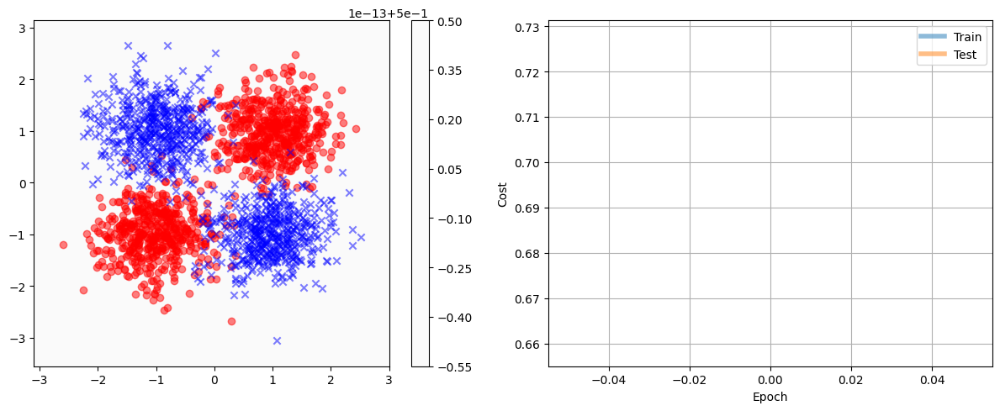

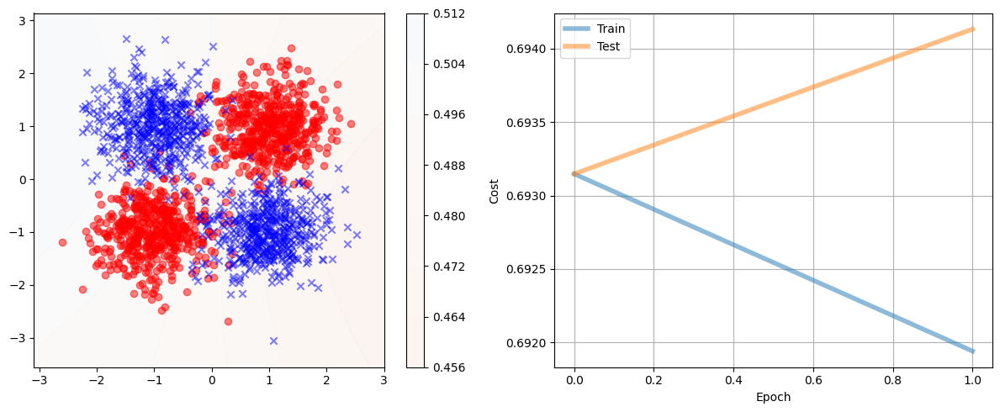

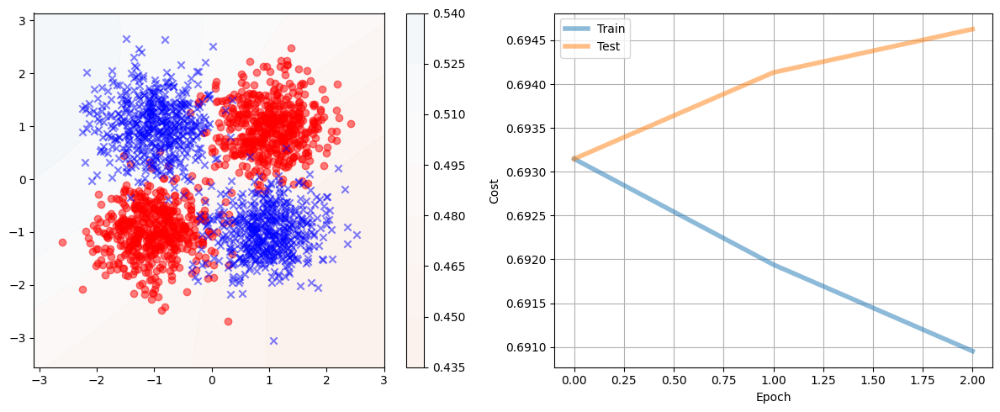

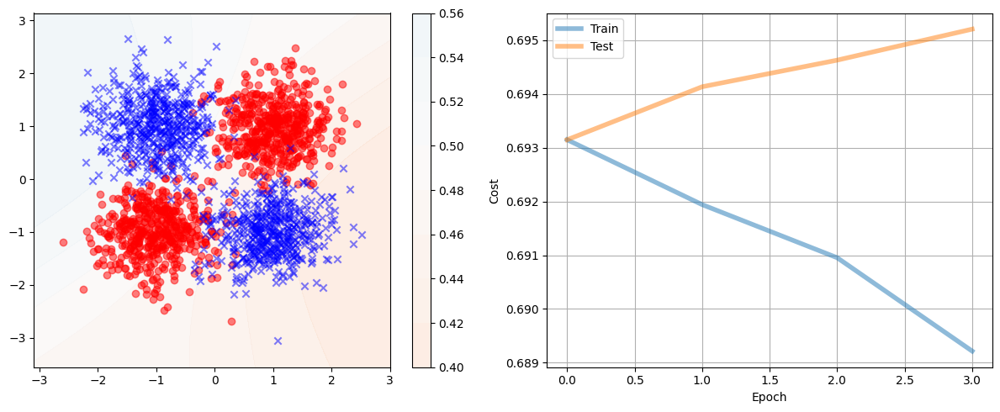

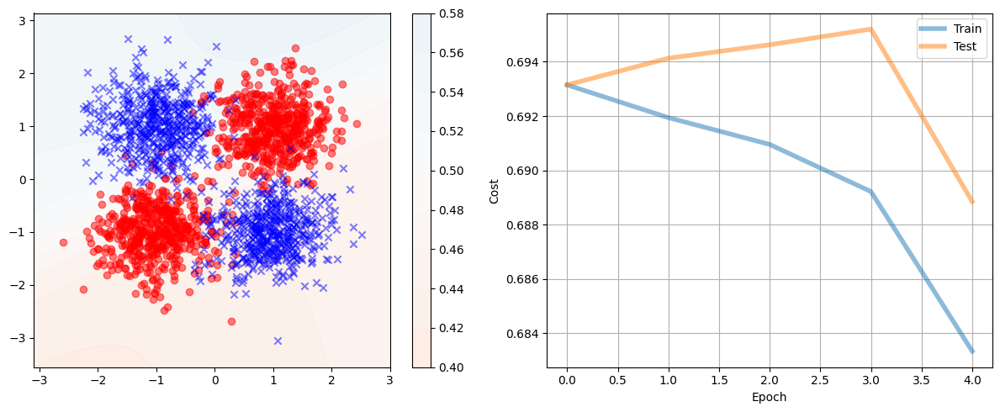

...

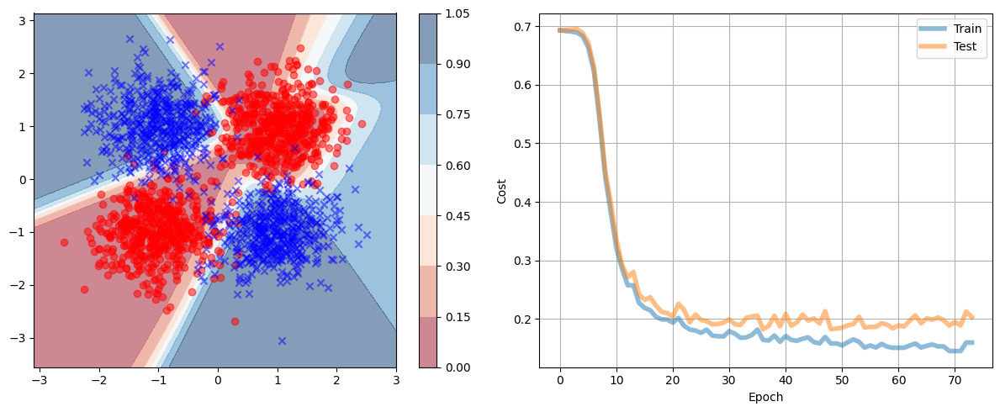

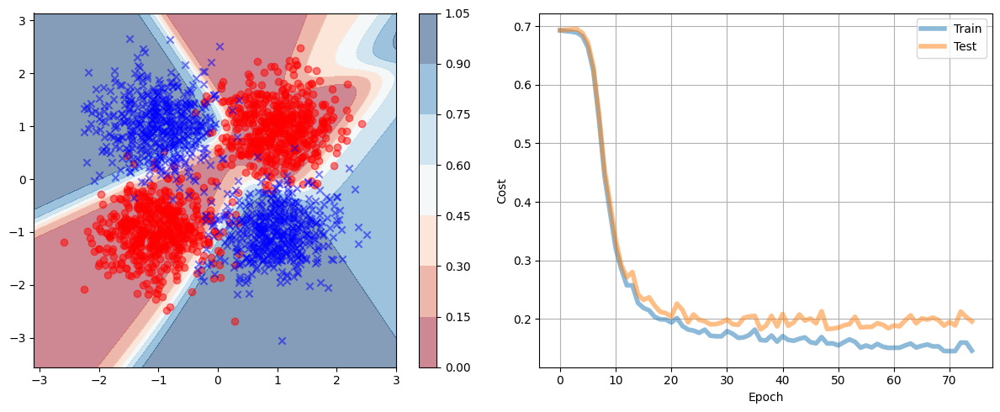

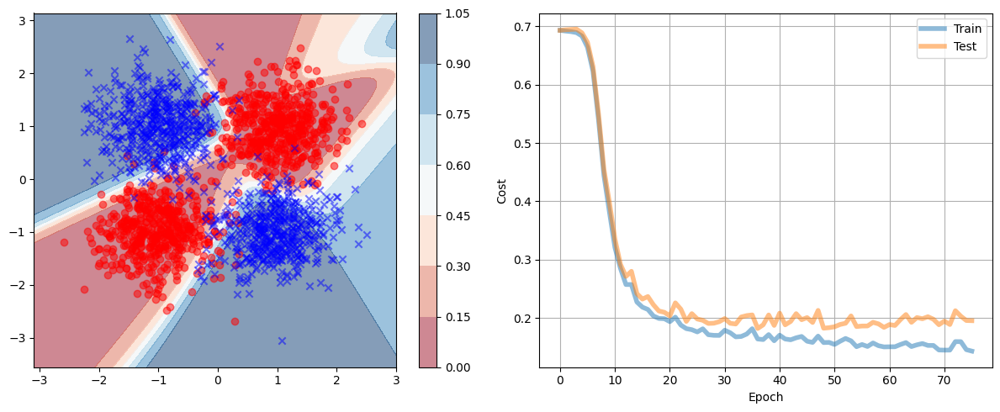

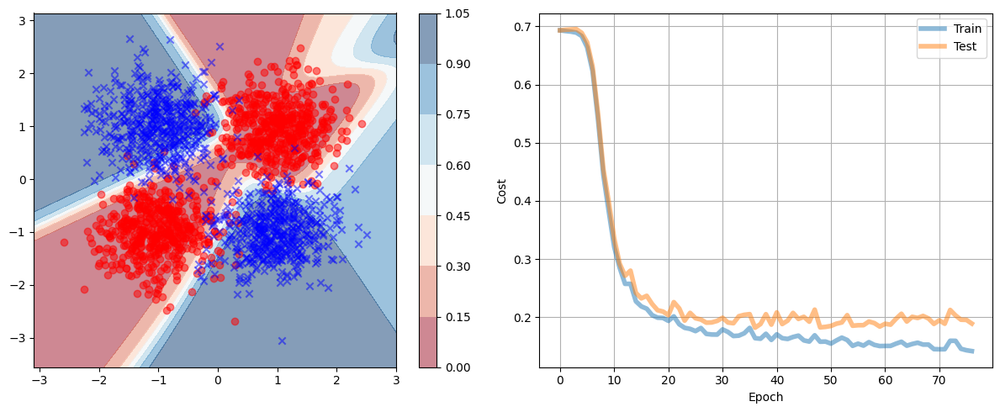

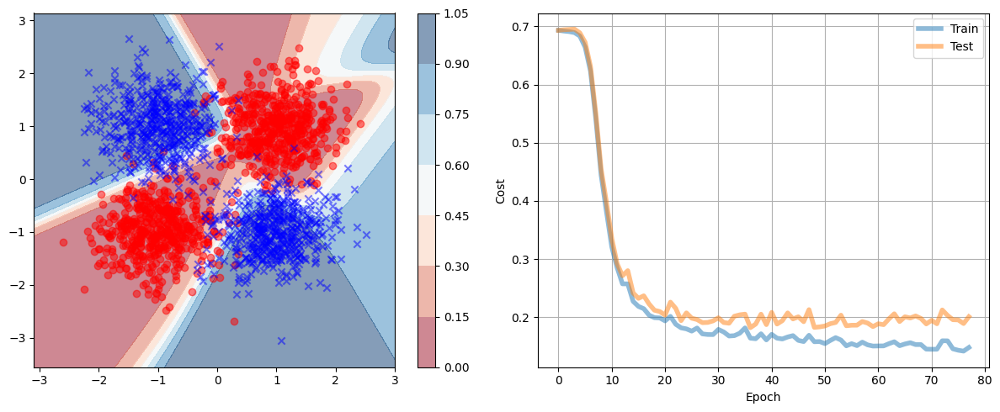

In [12]:
import time
start_cross = time.time()
for i in range(100):
    training_cross.update(X_train, Y_train, X_test, Y_test, batch_size=10)
    pred_labels = classifier_cross.predict(X_test)

    fig = plt.figure(figsize=(12, 5))
    ax = fig.add_subplot(1, 2, 1)
    Z = classifier_cross.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:,0]
    cf = ax.contourf(xx, yy, Z.reshape(xx.shape), cmap=plt.cm.RdBu, alpha=0.5, vmin=0.0, vmax=1.0)
    plt.colorbar(cf)
    ax.scatter(X[Y==0, 0], X[Y==0, 1], color='r', marker='o', alpha=0.5)
    ax.scatter(X[Y==1, 0], X[Y==1, 1], color='b', marker='x', alpha=0.5)

    ax = fig.add_subplot(1, 2, 2)
    ax.plot(np.arange(0, training_cross.current_epoch, step=1), 
        training_cross.train_cost[:training_cross.current_epoch], linewidth=4, alpha=0.5, label="Train")
    ax.plot(np.arange(0, training_cross.current_epoch, step=1), 
        training_cross.test_cost[:training_cross.current_epoch], linewidth=4, alpha=0.5, label="Test")
    ax.set_xlabel('Epoch')
    ax.set_ylabel('Cost')
    plt.legend()
    plt.grid()
    plt.tight_layout()
    
    if(training_cross.train_cost[:training_cross.current_epoch].mean() < 0.23):
        end_cross = time.time()
        break
        
print("i: ",i)
print("times:",end_cross-start_cross)

Calculate the accuracy

In [13]:
cross_true = 0
for i in pred_labels:
    if i[0] == True:
        cross_true+=1
print("The accuracy of Cross entropy is ", cross_true/1500.0)

The accuracy of Cross entropy is  0.478


#### Conclusion

* The accuracy of cross entropy is 47.8%
* We need to train it 77 times and cost 4.9754 seconds
* So there is no difference in the speed of cross-entropy and mse and the accuracy is same too.

# Tensorflow implementation

Let's use:

- A cross-entropy error cost function
- An output layer with one neuron (two classes) and sigmoid activation function
- A single hidden layer with tanh activation function
- An ADAM learning rate
- Batch-mode

In [16]:
import tensorflow as tf
print("Tensorflow version: " + tf.__version__)

Tensorflow version: 2.9.0


Let's reload our data... You know, just in case lazy professor does not want to pip install scipy in his `conx2` environment🤭

In [96]:
import pickle

# open a file, where you stored the pickled data
file1 = open(r'make_blobs1.pck', 'rb')
file2 = open(r'make_blobs2.pck', 'rb')

# dump information to that file
(X, y) = pickle.load(file1)
(X_train, X_test, y_train, y_test) = pickle.load(file2)

# close the file
file1.close()
file2.close()

In [97]:
X_train.shape, y_train.shape

((500, 2), (500,))

<br />
<center>
<img src =ipynb.images/keras-layers.png width = 500 />
</center>

In a Keras layer, **shapes** are tuples representing how many elements an array or tensor has in each dimension. 
For Example: A tensor with shape (3, 4, 4) is 3 dimensional with the first dimension having 3 elements. Each of these 3 elements has 4 elements, and each of these 4 elements has 4 elements. Thus a total of 3*4*4 = 48 elements.

In a Keras layer, the input shape is generally the shape of the input data provided to the Keras model while training. The model cannot know the shape of the training data. The shape of other tensors(layers) is computed automatically. 
Each type of Keras layer requires the input with a certain number of dimensions:

Dense layers require inputs as: `(batch_size, input_size)`

2D convolutional layers need inputs as:
- if using channels_last: `(batch_size, imageside1, imageside2, channels)`

- if using channels_first: `(batch_size, channels, imageside1, imageside2)`

1D convolutions and recurrent layers use: `(batch_size, sequence_length, features)`

The shape of other tensors is computed based on the number of units provided along with other particularities like kernel_size in the Conv2D layer.

This is how you use Keras' **sequential** API:
```
from keras.models import Sequential  
from keras.layers import * 

model = Sequential()    
model.add(Input(shape=(3,))) # Input tensor
model.add(Dense(units=4)) # hidden layer 1
model.add(Dense(units=4)) #hidden layer 2
model.add(Dense(units=1)) #output layer 
```

This is how you use Keras' **functional** API:
```
from keras.models import Model   
from keras.layers import * 

inputs = Input(shape=(3,)) # input tensor
hidden1 = Dense(units=4)(inputs) # hidden layer 1
hidden2 = Dense(units=4)(hidden1) # hidden layer 2
outputs = Dense(units=1)(hidden2) # hidden layer 1


#define the model's start and end points    
model = Model(inputs, outputs)
```

In a Keras layer, **weights** are the matrix capable of transforming the input shape into the output shape by some learned mathematical operation. 

Weights can be matrices, tensors, or high-dimensional tensors. They will be entirely automatically calculated based on the input and output shapes. 

Using batch gradient descent and the sequential API, we would build our network this way:

In [60]:
from tensorflow import keras
model = keras.models.Sequential()
model.add(keras.layers.Input(shape=[None, 2]))
model.add(keras.layers.Dense(5, activation="tanh"))
# model.add(keras.layers.Dense(5, activation="relu"))
model.add(keras.layers.Dense(1, activation="sigmoid"))

In [62]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_16 (Dense)            (None, None, 5)           15        
                                                                 
 dense_17 (Dense)            (None, None, 1)           6         
                                                                 
Total params: 21
Trainable params: 21
Non-trainable params: 0
_________________________________________________________________


In [63]:
from keras import losses 
from keras import metrics

model.compile(loss = 'mean_squared_error', metrics = [metrics.categorical_accuracy])
#model.compile(loss = 'categorical_crossentropy', metrics = [metrics.categorical_accuracy])

### Keras 32 batch training

In [100]:
history1 = model.fit(X_train, y_train, epochs = 100, batch_size=32, validation_data=(X_test, y_test))

Epoch 1/100
16/16 [==============================] - 0s 23ms/step - loss: 0.0246 - categorical_accuracy: 1.0000 - val_loss: 0.0398 - val_categorical_accuracy: 1.0000
Epoch 2/100
16/16 [==============================] - 0s 19ms/step - loss: 0.0246 - categorical_accuracy: 1.0000 - val_loss: 0.0398 - val_categorical_accuracy: 1.0000
Epoch 3/100
16/16 [==============================] - 0s 18ms/step - loss: 0.0246 - categorical_accuracy: 1.0000 - val_loss: 0.0398 - val_categorical_accuracy: 1.0000
Epoch 4/100
16/16 [==============================] - 0s 18ms/step - loss: 0.0246 - categorical_accuracy: 1.0000 - val_loss: 0.0398 - val_categorical_accuracy: 1.0000
Epoch 5/100
16/16 [==============================] - 0s 18ms/step - loss: 0.0246 - categorical_accuracy: 1.0000 - val_loss: 0.0398 - val_categorical_accuracy: 1.0000
Epoch 6/100
16/16 [==============================] - 0s 18ms/step - loss: 0.0246 - categorical_accuracy: 1.0000 - val_loss: 0.0398 - val_categorical_accuracy: 1.0000
Epoc

16/16 [==============================] - 0s 18ms/step - loss: 0.0244 - categorical_accuracy: 1.0000 - val_loss: 0.0396 - val_categorical_accuracy: 1.0000
Epoch 51/100
16/16 [==============================] - 0s 18ms/step - loss: 0.0245 - categorical_accuracy: 1.0000 - val_loss: 0.0396 - val_categorical_accuracy: 1.0000
Epoch 52/100
16/16 [==============================] - 0s 18ms/step - loss: 0.0245 - categorical_accuracy: 1.0000 - val_loss: 0.0396 - val_categorical_accuracy: 1.0000
Epoch 53/100
16/16 [==============================] - 0s 18ms/step - loss: 0.0245 - categorical_accuracy: 1.0000 - val_loss: 0.0396 - val_categorical_accuracy: 1.0000
Epoch 54/100
16/16 [==============================] - 0s 20ms/step - loss: 0.0244 - categorical_accuracy: 1.0000 - val_loss: 0.0396 - val_categorical_accuracy: 1.0000
Epoch 55/100
16/16 [==============================] - 0s 18ms/step - loss: 0.0244 - categorical_accuracy: 1.0000 - val_loss: 0.0395 - val_categorical_accuracy: 1.0000
Epoch 56/10

16/16 [==============================] - 0s 18ms/step - loss: 0.0242 - categorical_accuracy: 1.0000 - val_loss: 0.0395 - val_categorical_accuracy: 1.0000
Epoch 100/100
16/16 [==============================] - 0s 19ms/step - loss: 0.0243 - categorical_accuracy: 1.0000 - val_loss: 0.0395 - val_categorical_accuracy: 1.0000


In [40]:
# model.evaluate(x_test, y_test)

2023-03-22 00:49:22.145200: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:113] Plugin optimizer for device_type GPU is enabled.


313/313 [==============================] - 9s 24ms/step - loss: 6.7474 - accuracy: 0.3346


[6.747401714324951, 0.3346000015735626]

### Keras 64 batch training

In [99]:
history2 = model.fit(X_train, y_train, epochs = 100, batch_size=64, validation_data=(X_test, y_test))

Epoch 1/100
8/8 [==============================] - 0s 55ms/step - loss: 0.0248 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 2/100
8/8 [==============================] - 0s 23ms/step - loss: 0.0248 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 3/100
8/8 [==============================] - 0s 23ms/step - loss: 0.0248 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 4/100
8/8 [==============================] - 0s 24ms/step - loss: 0.0248 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 5/100
8/8 [==============================] - 0s 20ms/step - loss: 0.0248 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 6/100
8/8 [==============================] - 0s 21ms/step - loss: 0.0248 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 7/100
8/8 

Epoch 51/100
8/8 [==============================] - 0s 20ms/step - loss: 0.0247 - categorical_accuracy: 1.0000 - val_loss: 0.0398 - val_categorical_accuracy: 1.0000
Epoch 52/100
8/8 [==============================] - 0s 20ms/step - loss: 0.0247 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoch 53/100
8/8 [==============================] - 0s 23ms/step - loss: 0.0247 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoch 54/100
8/8 [==============================] - 0s 22ms/step - loss: 0.0247 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoch 55/100
8/8 [==============================] - 0s 19ms/step - loss: 0.0247 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoch 56/100
8/8 [==============================] - 0s 19ms/step - loss: 0.0247 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoch 57/1

### Keras 16 batch training

In [98]:
history3 = model.fit(X_train, y_train, epochs = 100, batch_size=16, validation_data=(X_test, y_test))

Epoch 1/100
32/32 [==============================] - 1s 18ms/step - loss: 0.0252 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoch 2/100
32/32 [==============================] - 1s 17ms/step - loss: 0.0252 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoch 3/100
32/32 [==============================] - 1s 17ms/step - loss: 0.0252 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoch 4/100
32/32 [==============================] - 1s 17ms/step - loss: 0.0252 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoch 5/100
32/32 [==============================] - 1s 17ms/step - loss: 0.0252 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoch 6/100
32/32 [==============================] - 1s 17ms/step - loss: 0.0252 - categorical_accuracy: 1.0000 - val_loss: 0.0397 - val_categorical_accuracy: 1.0000
Epoc

32/32 [==============================] - 1s 20ms/step - loss: 0.0251 - categorical_accuracy: 1.0000 - val_loss: 0.0398 - val_categorical_accuracy: 1.0000
Epoch 51/100
32/32 [==============================] - 1s 20ms/step - loss: 0.0250 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 52/100
32/32 [==============================] - 1s 18ms/step - loss: 0.0250 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 53/100
32/32 [==============================] - 1s 17ms/step - loss: 0.0250 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 54/100
32/32 [==============================] - 1s 17ms/step - loss: 0.0250 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 55/100
32/32 [==============================] - 1s 17ms/step - loss: 0.0250 - categorical_accuracy: 1.0000 - val_loss: 0.0398 - val_categorical_accuracy: 1.0000
Epoch 56/10

32/32 [==============================] - 1s 17ms/step - loss: 0.0248 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000
Epoch 100/100
32/32 [==============================] - 1s 17ms/step - loss: 0.0249 - categorical_accuracy: 1.0000 - val_loss: 0.0399 - val_categorical_accuracy: 1.0000


### Keras 1 batch training

In [67]:
history4 = model.fit(X_train, y_train, epochs = 100, batch_size=1)

Epoch 1/100
500/500 [==============================] - 4s 7ms/step - loss: 0.0314 - categorical_accuracy: 1.0000
Epoch 2/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0312 - categorical_accuracy: 1.0000
Epoch 3/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0309 - categorical_accuracy: 1.0000
Epoch 4/100
500/500 [==============================] - 3s 7ms/step - loss: 0.0306 - categorical_accuracy: 1.0000
Epoch 5/100
500/500 [==============================] - 3s 7ms/step - loss: 0.0304 - categorical_accuracy: 1.0000
Epoch 6/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0301 - categorical_accuracy: 1.0000
Epoch 7/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0299 - categorical_accuracy: 1.0000
Epoch 8/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0298 - categorical_accuracy: 1.0000
Epoch 9/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0299 - categorical_

500/500 [==============================] - 3s 6ms/step - loss: 0.0267 - categorical_accuracy: 1.0000
Epoch 73/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0265 - categorical_accuracy: 1.0000
Epoch 74/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0265 - categorical_accuracy: 1.0000
Epoch 75/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0264 - categorical_accuracy: 1.0000
Epoch 76/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0265 - categorical_accuracy: 1.0000
Epoch 77/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0264 - categorical_accuracy: 1.0000
Epoch 78/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0265 - categorical_accuracy: 1.0000
Epoch 79/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0264 - categorical_accuracy: 1.0000
Epoch 80/100
500/500 [==============================] - 3s 6ms/step - loss: 0.0264 - categorical_accu

## Visualize the history of each batch

In [103]:
import numpy as np
print("Numpy version: "+np.__version__)
%matplotlib inline
import matplotlib.pylab as plt
print("Matplotlib version: "+plt.__version__)

Numpy version: 1.23.2
Matplotlib version: 1.23.2


In [104]:
import numpy as np

x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5
xx, yy = np.meshgrid(np.arange(x_min, x_max, 0.05), np.arange(y_min, y_max, 0.05))

In [105]:
yhat = model.predict(np.c_[xx.ravel(), yy.ravel()])

458/458 [==============================] - 1s 2ms/step


In [106]:
yhatp = yhat.reshape(xx.shape)

#### Visualize 1 batch size history

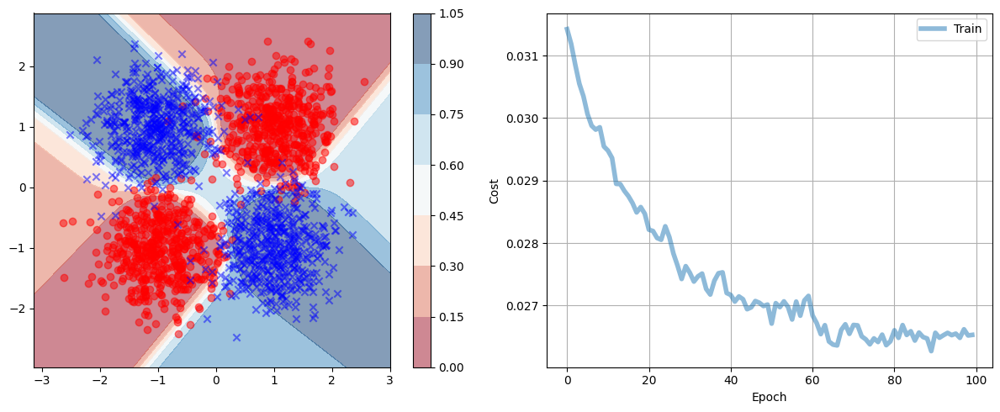

In [92]:
fig = plt.figure(figsize=(12, 5))
ax = fig.add_subplot(1, 2, 2)
plt.plot(history4.history['loss'], linewidth=4, alpha=0.5, label='Train')
plt.ylabel('Cost')
plt.xlabel('Epoch')
plt.legend()
plt.grid()
plt.legend()
ax = fig.add_subplot(1, 2, 1)

cf = ax.contourf(xx, yy, yhatp, cmap=plt.cm.RdBu, alpha=0.5, vmin=0.0, vmax=1.0)
plt.colorbar(cf)
ax.scatter(X[y==0, 0], X[y==0, 1], color='r', marker='o', alpha=0.5)
ax.scatter(X[y==1, 0], X[y==1, 1], color='b', marker='x', alpha=0.5)
plt.tight_layout()

#### Visualize 16 batch size history

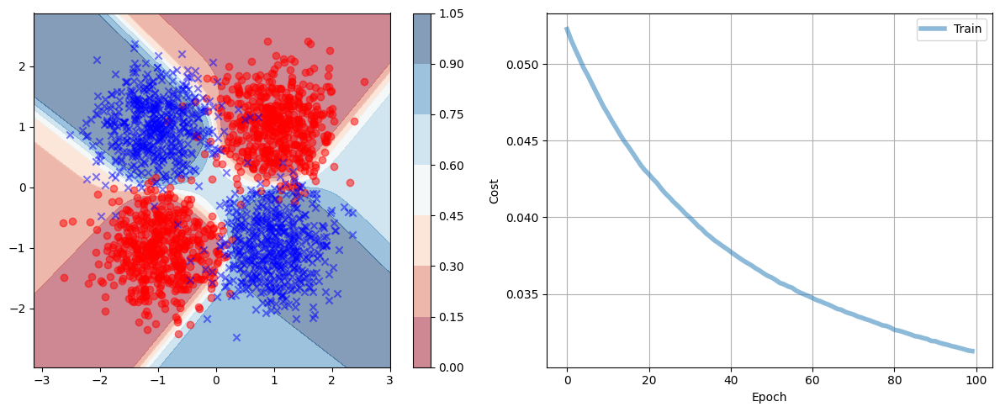

In [91]:
fig = plt.figure(figsize=(12, 5))
ax = fig.add_subplot(1, 2, 2)
plt.plot(history3.history['loss'], linewidth=4, alpha=0.5, label='Train')
plt.ylabel('Cost')
plt.xlabel('Epoch')
plt.legend()
plt.grid()
plt.legend()
ax = fig.add_subplot(1, 2, 1)

cf = ax.contourf(xx, yy, yhatp, cmap=plt.cm.RdBu, alpha=0.5, vmin=0.0, vmax=1.0)
plt.colorbar(cf)
ax.scatter(X[y==0, 0], X[y==0, 1], color='r', marker='o', alpha=0.5)
ax.scatter(X[y==1, 0], X[y==1, 1], color='b', marker='x', alpha=0.5)
plt.tight_layout()

#### Visualize 64 batch size history

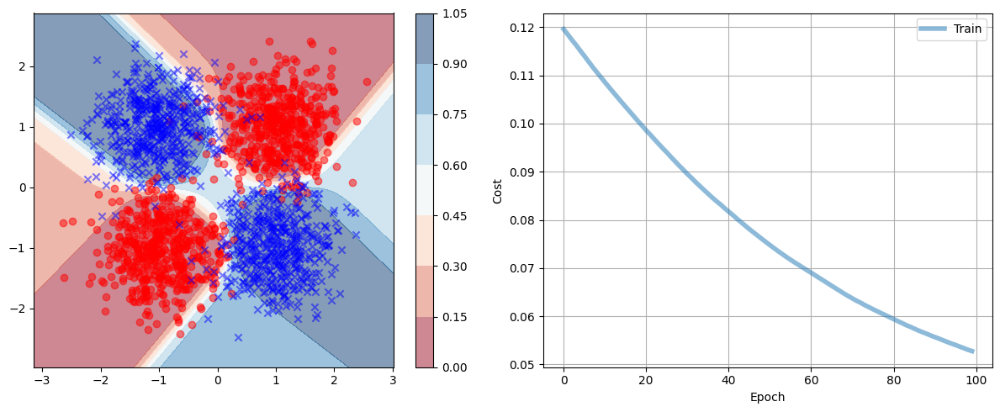

In [90]:
fig = plt.figure(figsize=(12, 5))
ax = fig.add_subplot(1, 2, 2)
plt.plot(history2.history['loss'], linewidth=4, alpha=0.5, label='Train')
plt.ylabel('Cost')
plt.xlabel('Epoch')
plt.legend()
plt.grid()
plt.legend()
ax = fig.add_subplot(1, 2, 1)

cf = ax.contourf(xx, yy, yhatp, cmap=plt.cm.RdBu, alpha=0.5, vmin=0.0, vmax=1.0)
plt.colorbar(cf)
ax.scatter(X[y==0, 0], X[y==0, 1], color='r', marker='o', alpha=0.5)
ax.scatter(X[y==1, 0], X[y==1, 1], color='b', marker='x', alpha=0.5)
plt.tight_layout()

#### Visualize 32 batch size history

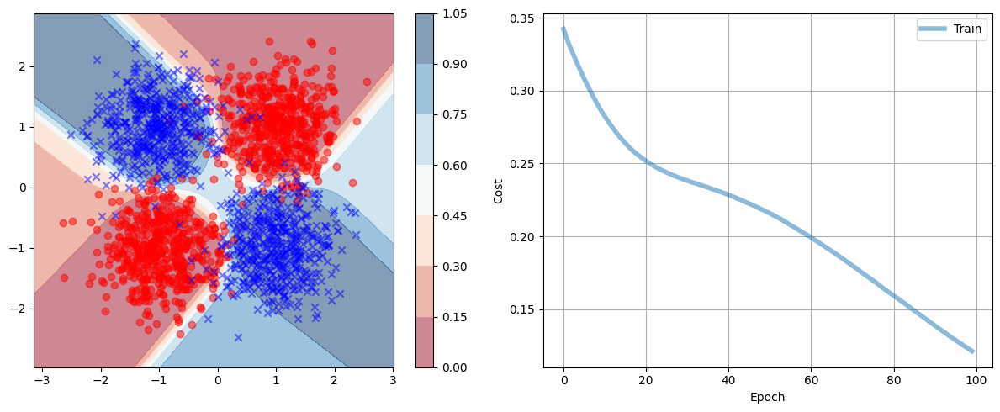

In [89]:
fig = plt.figure(figsize=(12, 5))
ax = fig.add_subplot(1, 2, 2)
plt.plot(history1.history['loss'], linewidth=4, alpha=0.5, label='Train')
plt.ylabel('Cost')
plt.xlabel('Epoch')
plt.legend()
plt.grid()
plt.legend()
ax = fig.add_subplot(1, 2, 1)

cf = ax.contourf(xx, yy, yhatp, cmap=plt.cm.RdBu, alpha=0.5, vmin=0.0, vmax=1.0)
plt.colorbar(cf)
ax.scatter(X[y==0, 0], X[y==0, 1], color='r', marker='o', alpha=0.5)
ax.scatter(X[y==1, 0], X[y==1, 1], color='b', marker='x', alpha=0.5)
plt.tight_layout()

#### Conclusion

So we can see all of the different batch size's accuracy are same and get 100% very quickly and the val_categorical_accuracy is 100% too. So, there is no problem of overfitting. 

The speed of 32 batch size runs fastest. So the best batch size for MSE is 32.